In [1]:
%%HTML
<style>
.theorem {
  display: block;
  font-style: italic;
  color: black;
}
.theorem::before {
  content: "Theorem. ";
  font-weight: bold;
  font-style: normal;
}
.theorem[text]::before {
  content: "Theorem (" attr(text) ") ";
  font-weight: bold;
  font-style: normal;
}
.theorem p {
  display: inline;
}

.example {
  display: block;
  font-style: italic;
  color: black;
}
.example::before {
  content: "Example. ";
  font-weight: bold;
  font-style: normal;
}
.example p {
  display: inline;
}

</style>

In [2]:
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
import scipy.integrate as integrate
_ = np.seterr(all="ignore")

In [54]:
def animate(trajectories_1, trajectories_2):
    fig, ax = plt.subplots(figsize = (16, 4))
    T = trajectories_1.shape[1]
    linspace = np.arange(1, T+1)
    ln_1, = plt.plot(linspace, trajectories_1[0])
    ln_2, = plt.plot(linspace, trajectories_2[0])
    
    y_lim = np.min(trajectories_1), np.max(trajectories_1)
    ax.set_ylim(*y_lim)
    
    def init():
        ln_1.set_ydata(trajectories_1[0])
        ln_2.set_ydata(trajectories_2[0])
        return ln_1, ln_2

    def update(frame):
        ln_1.set_ydata(trajectories_1[frame])
        ln_2.set_ydata(trajectories_2[frame])
        return ln_1, ln_2

    ani = FuncAnimation(fig, update, frames=len(trajectories_1),
                        init_func=init, blit=True, interval=250)
    
    plt.close()
    return HTML(ani.to_jshtml())


# Coupling Methods for Monte Carlo

## From variance reduction to unbiased particle smoothing.

<br><br>
<br><br>
<br><br>



## Aalto university, EEA

Adrien Corenflos, 27/09/2021

## Outline

1. What are these Monte Carlo things again?

2. Couplings et al.

3. Unbiased estimates of path functionals (🐻 with me).

4. A fresh start for Markov chain Monte Carlo.

5. "I came to hear about particle filters though."

## What are these Monte Carlo things again?

<div>
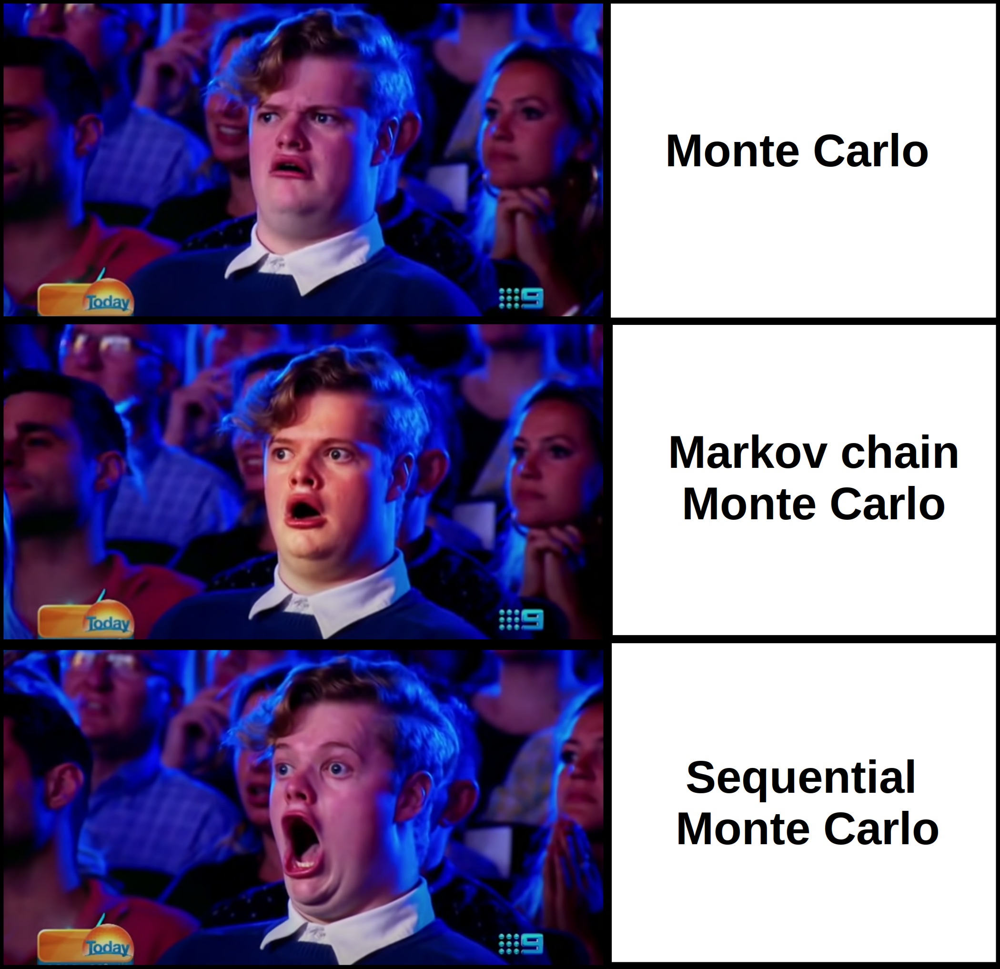
</div>


### Monte Carlo


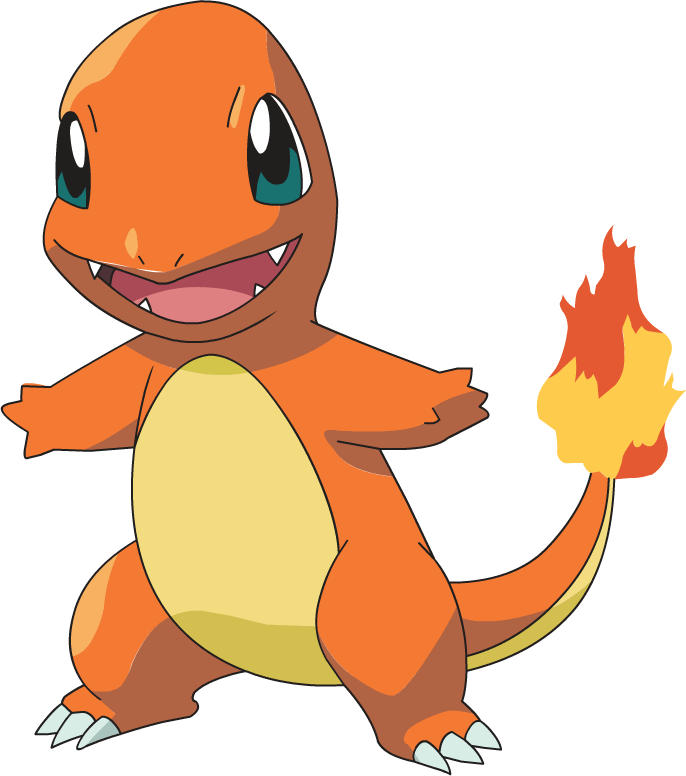

- $X_1, X_2, \ldots \sim \pi$ 

- $\pi_N = \frac{1}{N}\sum_{n=1}^N \delta_{X_n}$

- $\pi(\varphi) = \mathbb{E}_{X \sim \pi}\left[\varphi(X)\right]$

- $\pi_N(\varphi)(\omega) = \frac{1}{N}\sum_{n=1}^N \varphi(X_n(\omega))$

<div class="theorem" text="Law of Large numbers">
  If the $X_i$'s are i.i.d., and if $\pi(\varphi)$ exists, then $\pi_N(\varphi) \to \pi(\varphi)$ almost surely.
</div>

<div class="example">
  We can compute the variance of a standard normal distribution.
</div>

In [4]:
X_i = np.random.normal(size=(1000,))
np.mean(X_i ** 2)

1.0117323145996624

<div class="theorem" text='CLT'>
  If $\pi(\varphi)$ exists, then $\mathbb{E}\left[\pi_N(\varphi)\right] = \pi(\varphi)$. Moreover, if $\pi(\varphi^2)$ exists, $\pi_N(\varphi) - \pi(\varphi) \approx \mathcal{N}(0, \frac{\pi(\varphi^2) - \pi(\varphi)^2}{N}).$
</div>

<div class="example">
  We can compute the variance of a standard normal distribution.
</div>

In [5]:
X_i = np.random.normal(size=(100,1000))
mu_Ns = np.mean(X_i ** 2, 0)
np.mean(mu_Ns), np.var(mu_Ns), np.var(X_i ** 2) / 100

(0.9930125562148696, 0.020922375833422692, 0.019660976157999256)

## Markov chain Monte Carlo

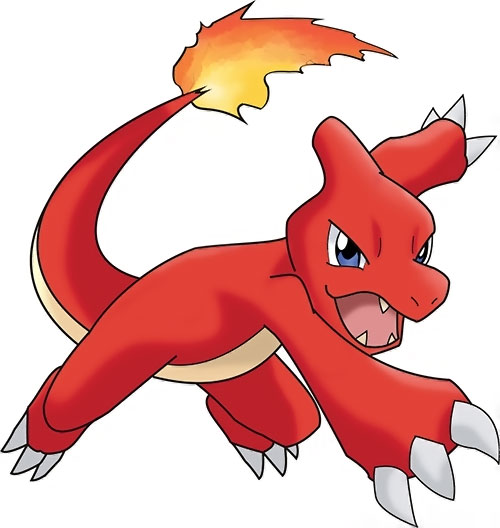

1. Target: $\pi$

2. Detailed balance method: build a Markov kernel $M(\mathrm{d}y \mid x)$  s.t.  $\pi(\mathrm{d}x) M(\mathrm{d}y \mid x) = M(\mathrm{d}x \mid y) \pi(\mathrm{d}y)$

3. Idea: $M(\mathrm{d}y \mid x) = \alpha(y, x) P(\mathrm{d}y \mid x) + [1 - \alpha(y, x)] \delta_{x}$

4. Algebra: $\alpha(y, x) = 1 \wedge \frac{\pi(\mathrm{d}y) P(\mathrm{d}x \mid y)}{\pi(\mathrm{d}x) P(\mathrm{d}y \mid x)}$

<div class="theorem" text="Ergodicity">
  If $\pi(\varphi)$ exists then $\frac{1}{T} \sum_{t=0}^T \varphi(X_t) \to \pi(\varphi)$ almost surely, where $X_t \sim M(\mathrm{d}x_t \mid X_{t-1})$.
</div>

5. $\mathbb{E}\left[\frac{1}{T} \sum_{t=0}^T \varphi(X_t)\right] \neq \pi(\varphi)$ 

#### Example

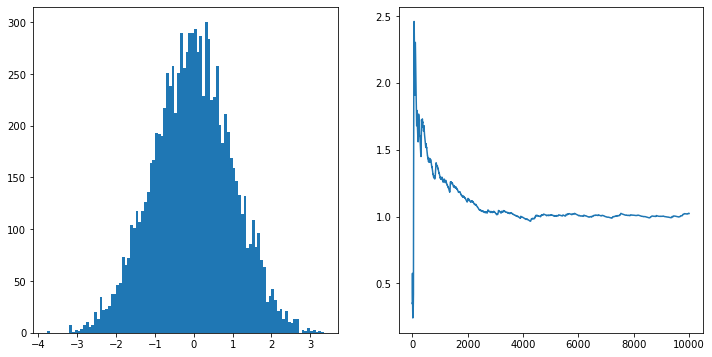

In [6]:
logpi = stats.norm.logpdf
p = lambda x: x + stats.uniform.rvs(loc=-1, scale=2)
logp = lambda y, x: stats.uniform.logpdf(y-x, loc=-1, scale=2)
alpha = lambda y, x: np.minimum(1, np.exp(logpi(y) + logp(x, y) - logpi(x) - logp(y, x)))
T = 10_000
chain = np.empty((T,))
x = np.random.randn()
chain[0] = x
us = np.random.rand(T-1)
for i in range(1, T):
    y = p(x)
    alpha_val = alpha(y, x)
    if us[i-1] < alpha_val:
        x = y        
    chain[i] = x

fig, axes = plt.subplots(ncols=2, figsize=(12, 6))
_ = axes[0].hist(chain, bins=100)
_ = axes[1].plot(np.cumsum(np.square(chain)) / np.arange(1, T + 1))

<div class="theorem" text='Central limit theorem'>
  If the $X_i$'s are i.i.d., and if $\mu(\varphi)$ and $\mu(\varphi^2)$ exist, then $\sqrt{N} \left[\mu_N(\varphi) - \mu(\varphi)\right] \to \mathcal{N}\left(0,  \mu(\varphi^2)\right)$.
</div>

### Sequential Monte Carlo

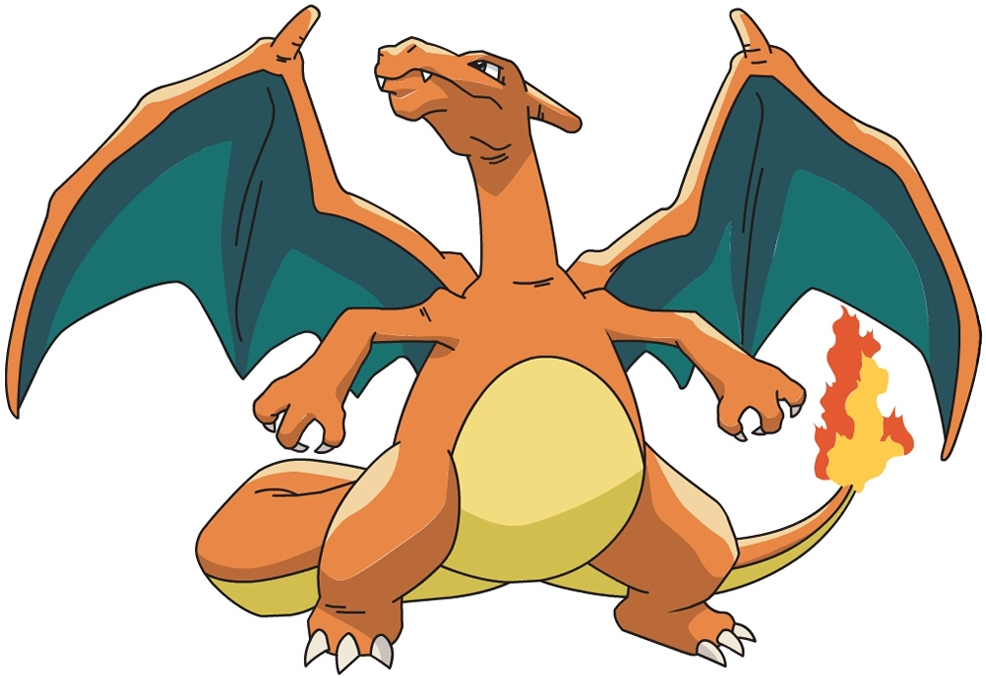

1. Target: $\pi_T(\mathrm{d}x_{0:T})$

2. Propagation equation: $\pi_{t+1}(\mathrm{d}x_{0:t+1}) = \int_{x_t} M_t(\mathrm{d}x_{t+1} \mid x_t)G_t(x_{t+1}, x_t) \pi_t(\mathrm{d}x_{0:t}) $

See how the integral is actually over the last term.

3. Sequential importance sampling: given $\sum_{n=1}^N W_t^n\delta_{X^n_{0:t}}$ sample $X^n_{t+1}\sim M_t(\mathrm{d}x_{t+1} \mid X^n_t)$, compute $w^n = W_t^n G_t(X^n_{t+1}, X^n_t)$ and form $W_{t+1}^n = \frac{w_n}{\sum_{m=1}^N w_m}$

<div class="theorem" text="SIS">
  $\pi^N_t \hat{=} \sum_{n=1}^N W_{t}^n \delta_{X^n_{0:t}} \to \pi_t$ 
</div>

<div class="theorem" text="SIS">
  $\exists n'$ s.t. $W_t^n \underset{t \to \infty}{\longrightarrow} \left\lbrace\begin{split}1 \text{ if } n' = n, \\ 0 \text{ otherwise.}  \end{split}\right.$ 
</div>

4. Resample: Sample $A^n_t$ s.t. $p(A^n_t = k) = W_t^k$, set $X_{0:t}^n = X_{0:t}^{A_t^n}$ and GOTO 3.

## Examples

Abuse of notations!

State-space models: $\left\lbrace\begin{split}X_{t+1} = f_t(X_t, \epsilon_t) \\ Y_{t} = g_t(X_t, \nu_t)\end{split}\right.$

Bootstrap: $M_t(\mathrm{d}x_{t+1} \mid x_t) \sim p(x_{t+1} \mid x_t)$ and $G_t(x_{t+1}, x_t) = p(y_t \mid x_t)$

Locally optimal: $M_t(\mathrm{d}x_{t+1} \mid x_t) \sim p(x_{t+1} \mid x_t, y_t)$ and $G_t(x_{t+1}, x_t) = p(y_t \mid x_t) p(x_{t+1} \mid x_t)$.

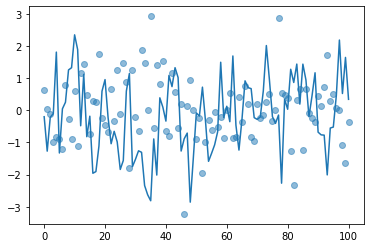

In [64]:
F = 2 * np.random.rand(1, 1) - 1
H = np.random.randn(1, 1)
T = 100
xs = np.random.randn(T+1, 1)
ys = np.random.randn(T+1, 1)
ys[0] += H @ xs[0]
for t in range(T):
    xs[t+1] += F @ xs[t]
    ys[t+1] += H @ xs[t+1]
    
_ = plt.plot(xs)
_ = plt.scatter(np.arange(T+1), ys, alpha=0.5)

## Algorithm

In [8]:
def multinomial(W):
    n_samples = W.shape[0]
    return np.searchsorted(np.cumsum(W), np.sort(np.random.rand(n_samples)))

def pf(n_samples):
    xs = np.empty((T+1, 1, n_samples))
    xs[0] = np.random.randn(1, n_samples)
    w = stats.multivariate_normal.pdf(ys[None, 0] - (H @ xs[0]).T)
    W = w / w.sum()
    A = multinomial(W)
    xs = xs[..., A]
    for t in range(T):
        xs[t+1] = F @ xs[t] + np.random.randn(1, n_samples)
        w = stats.multivariate_normal.pdf(ys[None, t+1] - (H @ xs[t+1]).T)
        W = w / w.sum()
        A = np.searchsorted(np.cumsum(W), np.sort(np.random.rand(n_samples)))
        xs = xs[..., A]
    return xs

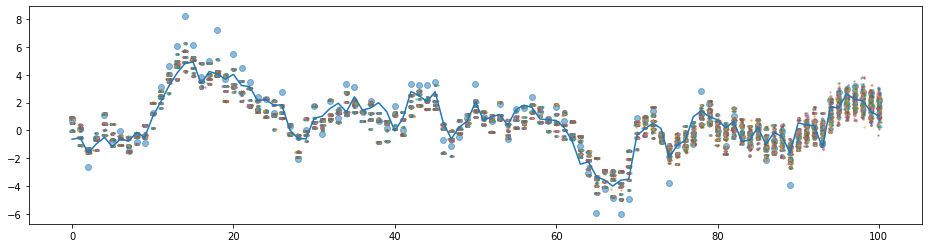

In [9]:
filter_sol = pf(500)
_ = plt.figure(figsize=(16, 4))
_ = plt.plot(xs)
_ = plt.scatter(np.arange(T+1), ys, alpha=0.5)
for traj in filter_sol[:, 0].T:
    _ = plt.scatter(np.arange(T+1) + 1e-1 * np.random.randn(T+1), 
                    traj + 1e-2 * np.random.randn(T+1), alpha=0.5, s=2)

## Couplings et al.

<br>
<br>

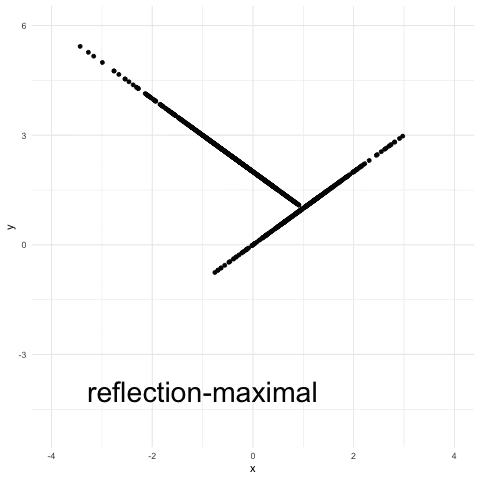
Credit: https://sites.google.com/site/pierrejacob/cmclectures

## Definition

Marginals: 
\begin{equation}
    X \sim p_X, \quad Y \sim p_Y
\end{equation}

Coupling:
\begin{equation}
    (X, Y) \sim p_{XY}, \quad \text{s.t. } \int_y p_{XY} = p_X, \int_x p_{XY} = p_Y
\end{equation}

## Example

Independent: 
\begin{equation}
    p_{XY}(x, y) = p_X(x) p_Y(y)
\end{equation}

Optimal transport: 
\begin{equation}
    p_{XY} = \underset{\Gamma}{\textrm{argmin}}\, \mathbb{E}_{\Gamma}\left[d(X,Y)\right]
\end{equation}

Max coupling: 
\begin{equation}
    \underset{\Gamma}{\textrm{argmax}}\, \mathbb{P}(X=Y) = \underset{\Gamma}{\textrm{argmin}}\, \mathbb{P}(X\neq Y)
\end{equation}

Min coupling: 
\begin{equation}
    \underset{\Gamma}{\textrm{argmin}}\, \mathbb{P}(X=Y)
\end{equation}

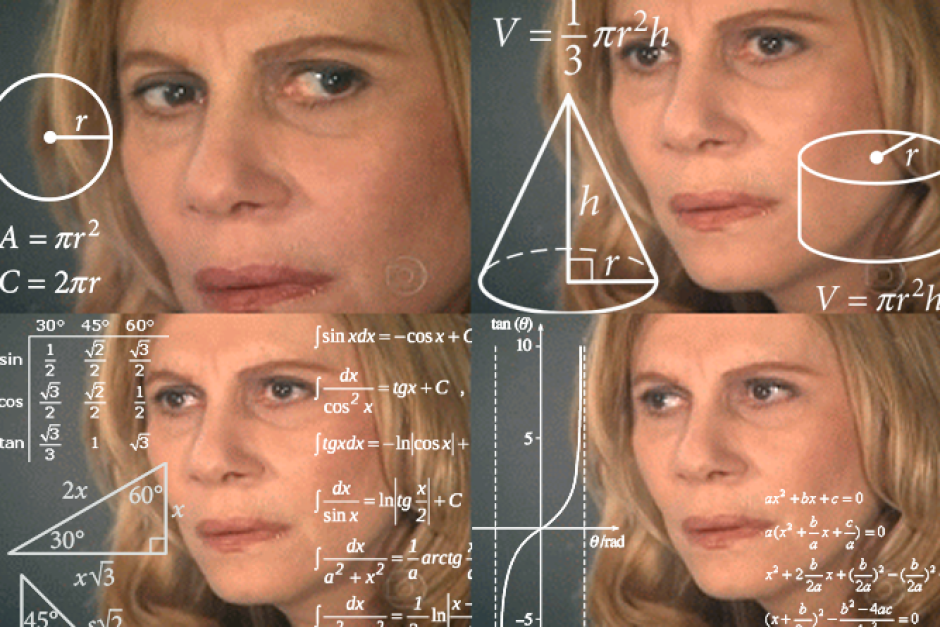

## Max coupling

<div class="theorem" text="Total variation">
    $||p_X - p_Y||_{TV} = \sup_{A} p_X(A) - p_Y(A) = \min_{(X,Y)}\mathbb{P}(X \neq Y)$  
</div>

This identity can be used to derive a number of convergence results (in particular for MCMC results) as it is sometimes easier to explicitely build a coupling (not necessarily the max coupling) than to compute the TV, for example this was used to study the convergence of the particle Gibbs algorithm by Chopin and Singh.

Sampling from a max-coupling is a bit complicated, and relies on a mixture construction of it, and in general may have infinite compute time. In some particular cases however it is easier. Below is the so-called reflexion max-coupling for Gaussians with the same covariance matrix. (link to antithetic variables)

In [10]:
def _mvn_loglikelihood(x):
    return -0.5 * np.sum(x ** 2, -1)


def reflected_gaussians(sqrt_precision_matrix, sqrt_covariance_matrix, mu_1, mu_2, n_samples):

    shape = mu_1.shape[0]
    scaled_diff = sqrt_precision_matrix @ (mu_1 - mu_2)
    normed_scaled_diff = scaled_diff / np.linalg.norm(scaled_diff, 2)
    
    norm = np.random.randn(n_samples, shape)
    log_u = np.log(np.random.rand(n_samples))

    do_accept = log_u + _mvn_loglikelihood(norm) < _mvn_loglikelihood(norm + scaled_diff)
    reflected_norm = np.where(do_accept[:, None], 
                              norm + scaled_diff[None, :], 
                              norm - 2 * np.dot(norm, normed_scaled_diff)[:, None] * normed_scaled_diff)
    res_1 = mu_1[:, None] + sqrt_covariance_matrix @ norm.T
    res_2 = mu_2[:, None] + sqrt_covariance_matrix @ reflected_norm.T

    return res_1.T, res_2.T

In [11]:
sqrt_cov = np.random.rand(1, 1)
norm_1, norm_2 = reflected_gaussians(1 / sqrt_cov, sqrt_cov, np.array([0.]), np.array([1.]), 100_000)
print(norm_1.mean(), norm_1.std(), norm_2.mean(), norm_2.std(), sqrt_cov, np.sum(np.abs(norm_1 - norm_2) < 1e-6))

6.973258898398114e-05 0.15924129813661742 0.999923550698486 0.15926238338949772 [[0.15857237]] 152


Convergence of random sequences is not the focus, but the next slide is somewhat important for getting a heuristical understanding of why one even think of using these methods for unbiased MC sampling.

## Couplings as a convergence proof method (quickly)


1. $X_n = f(X_{n-1}), \quad Y_n = f(Y_{n-1})$.

2. $X_0 \neq Y_0$.

3. For any coupling $(X_n, Y_n)$, $||p_{X_n} - p_{Y_n}||_{TV} \leq \mathbb{P}(X_n \neq Y_n)$.

4. Idea: build a coupling such that $\mathbb{P}(X_n \neq Y_n) \leq \lambda ||p_{X_{n-1}} - p_{Y_{n-1}}||_{TV}$, $\lambda < 1$.

## Unbiased estimates of path functionals (🐻 with me)

<br>
<br>
A fancy name for telescopic sums.

1. Problem statement: estimate $\sum_{k=1}^{\infty} x_k$ for some convergent series.

2. Naive solution: estimate $\sum_{k=1}^{K} x_k$.

3. Example: $1 = \sum_{k=1}^{\infty} \frac{1}{2^k} \approx 1 - \frac{1}{2^K}$ with "bias" $\frac{1}{2^K}$

## Unbiased statistical estimates

Let $p_k > 0$, $\sum_{k=1}^{\infty}p_k =1$

$\sum_{k=1}^{\infty} x_k = \sum_{k=1}^{\infty} x_k \frac{p_k}{p_k}$

This is essentially an importance sample.

In [13]:
mu = 1.
ks = 1 + stats.poisson.rvs(mu, size=(10_000,))
p_ks = stats.poisson.pmf(ks - 1, mu)
x_ks = 0.5 ** ks

np.mean(x_ks / p_ks), np.std(x_ks / p_ks)

(0.9928694271060944, 0.7309528827633828)

In [14]:
lam = 0.5
ks = stats.geom.rvs(lam, size=(10_000,))
p_ks = stats.geom.pmf(ks, lam)
x_ks = 0.5 ** ks

np.mean(x_ks / p_ks), np.std(x_ks / p_ks)

(1.0, 0.0)

## Example: Markov chains as path functionals

$\pi(\phi) = \underset{T \to \infty}{\lim} \frac{1}{T} \sum_{t=1}^T \phi(X_t)$ is not a path functional

$Z_t = \sum_{k=1} (-1)^{t+k} \mathbb{E}\left[\phi(X_k)\right]$

$Z_1 = \mathbb{E}\left[\phi(X_1)\right]$, $Z_2 = -\mathbb{E}\left[\phi(X_1)\right] + \mathbb{E}\left[\phi(X_2)\right]$, ...

$\pi(\phi) = \sum_{t=1}^\infty Z_{t+1} - Z_t$

In [15]:
z_t = np.repeat(np.expand_dims(chain ** 2, 0), 10_000, axis=0)
z_t *= (-1) ** (1 + np.arange(10_000 ** 2).reshape(10_000, 10_000) % 2)
z_t[np.triu_indices(10_000, 1)] = 0.
z_t = np.sum(z_t, 1)
delta_t = np.diff(z_t)

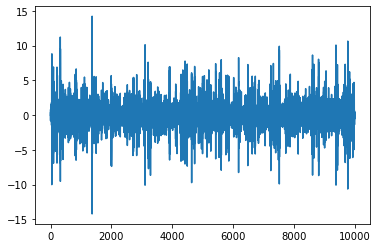

In [16]:
plt.plot(delta_t)

This does not converge to 0, so we can't apply the importance sampling trick.
But we can probably define $Z_t$ differently!

## A fresh start for Markov chain Monte Carlo

The telescopic sum only depends on expectations over the marginals, not the full chain!

1. $\pi(\phi) = \sum_{t=1}^\infty Z_{t+1} - Z_t = - \mathbb{E}\left[\phi(X_1)\right] + \sum_{t=2}^{\infty}\mathbb{E}\left[\phi(X_t)\right] - \mathbb{E}\left[\phi(Y_{t-1})\right]$ if $Y_t \sim \pi_t$.

Next line, need to emphasis that because of the mixture structure of MCMC kernel $M$, if the two chains are equal at any point they stay the same. This will be super useful due to the fact that the telescopic sums will have finite terms as long as the meeting time is quick enough.

2. Idea: couple $(X_t, Y_{t-1})$, with $X_t \sim M(\mathrm{d}x \mid X_t)$, $Y_t \sim M(\mathrm{d}y \mid Y_{t-1})$ with $M(\mathrm{d}y \mid x) = \alpha(y, x) P(\mathrm{d}y \mid x) + [1 - \alpha(y, x)] \delta_{x}$

3. Formally: coupled kernel $\tilde{M}(\mathrm{d}x_t, \mathrm{d}y_{t-1} \mid x_{t-1}, y_{t-2})$, with marginals by $M$.

## Lagged coupling of Markov chains

<u>Algorithm</u>

1. Sample $X_0 \sim \pi_0$, $Y_0 \sim \pi_0$
2. Sample $X_1 \sim M(\mathrm{d}x \mid X_{0})$
3. While $X_t \neq Y_{t-1}$ sample $X_t, Y_{t-1} \sim \tilde{M}(\mathrm{d}x_t, \mathrm{d}y_{t-1} \mid X_{t-1}, Y_{t-2})$

Let $\tau = \inf\{t \mid Y_{t-L} = X_t\}$

\begin{align}
\pi(\phi) 
    &= \frac{1}{m-k+1}\sum_{t=k}^m \mathbb{E}\left[\phi(X_t)\right] + \sum_{t=k+1}^{\infty}\min\left(1, \frac{t - k}{m-k + 1}\right)\left(\mathbb{E}\left[\phi(X_t)\right] - \mathbb{E}\left[\phi(Y_{t-1})\right]\right)\\
    &= \frac{1}{m-k+1}\sum_{t=k}^m \mathbb{E}\left[\phi(X_t)\right] + \sum_{t=k+1}^{\tau - 1}\min\left(1, \frac{t - k}{m-k + 1}\right)\left(\mathbb{E}\left[\phi(X_t)\right] - \mathbb{E}\left[\phi(Y_{t-1})\right]\right)
\end{align}

In [17]:
def estimator(Xs, Ys, k, m, phi):
    tau = len(Xs) - 1
    m = np.minimum(m, tau)
    weights = np.minimum(1, np.arange(1, tau - k + 1) / (m - k + 1))
    if tau - k < 1:
        return np.nan
    return np.mean(phi(Xs[k:m]), 0) + np.sum(weights * (phi(Xs[k+1:]) - phi(Ys[k:])))

### Coupling of random walk Metropolis (Rosenbluth) Hastings

In [18]:
def coupled_rwmrh(logpi, dim_x, lag, eps=1e-2):
    alpha = lambda y, x: np.minimum(1, np.exp(logpi(y) - logpi(x)))
    
    # burnin
    X_t = np.random.randn(dim_x)
    X_ts = [X_t]
    for _ in range(lag):
        X_t_star = X_t + eps * np.random.randn(dim_x)
        U = np.random.rand()
        X_t = X_t if U > alpha(X_t_star, X_t) else X_t_star
        X_ts.append(X_t)
    Y_t_1 = np.random.randn(dim_x)
    
    Y_ts = [Y_t_1]
    
    sqrt_cov_matrix = eps * np.eye(dim_x)
    sqrt_precision_matrix = np.eye(dim_x) / eps
    
    # contractive coupling
    while np.sum((X_t - Y_t_1) ** 2) > 1e-5 :
        X_t_star, Y_t_star = reflected_gaussians(sqrt_precision_matrix, sqrt_cov_matrix, X_t, Y_t_1, 1)
        X_t_star, Y_t_star = X_t_star[0], Y_t_star[0]
        U = np.random.rand()
        accept_X = U < alpha(X_t_star, X_t)
        accept_Y = U < alpha(Y_t_star, Y_t_1)
        
        X_t = X_t * (1 - accept_X) + accept_X * X_t_star
        Y_t_1 = Y_t_1 * (1 - accept_Y) + accept_Y * Y_t_star
        X_ts.append(X_t)
        Y_ts.append(Y_t_1)
    return np.stack(X_ts), np.stack(Y_ts)

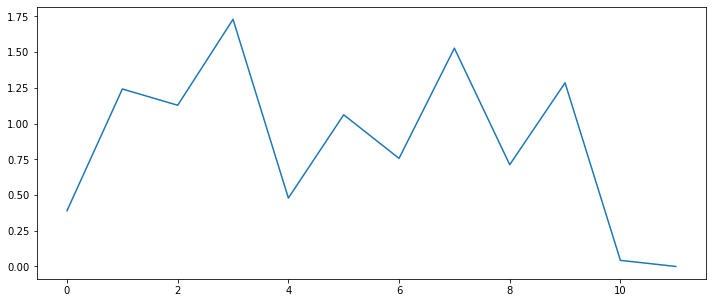

In [19]:
logpi = lambda x: -np.abs(x).sum(-1)
X_ts, Y_ts = coupled_rwmrh(logpi, 2, 1, eps=.25)

fig, ax = plt.subplots(figsize=(12, 5))

_ = ax.plot(np.sum((X_ts[1:] - Y_ts[:]) ** 2, -1))

Probably something wrong with the code here...

In [20]:
phi = lambda x: np.sum(x ** 2, -1)
n_samples = 1_000
estimates = np.empty((n_samples,))
standard_estimates = np.empty((n_samples,))
for i in range(n_samples):
    X_ts, Y_ts = coupled_rwmrh(logpi, 2, 1, eps=.1)
    estimates[i] = estimator(X_ts, Y_ts, 10, 30, phi)
    standard_estimates[i] = phi(X_ts).mean()
    print(f"iterate {i+1}/{n_samples}", end="\r")

In [21]:
np.nanmean(estimates), np.nanstd(estimates) / (1 - np.isnan(estimates)).sum() ** 0.5, np.isnan(estimates).sum()

(-7.867398576398655, 92.5699904095749, 74)

In [22]:
expected = integrate.dblquad(lambda x, y: (x ** 2 + y ** 2) * np.exp(logpi([x, y])) / 4, 
                             -np.inf, np.inf, -np.inf, np.inf)
expected

(3.999999999990443, 5.712168575420877e-08)

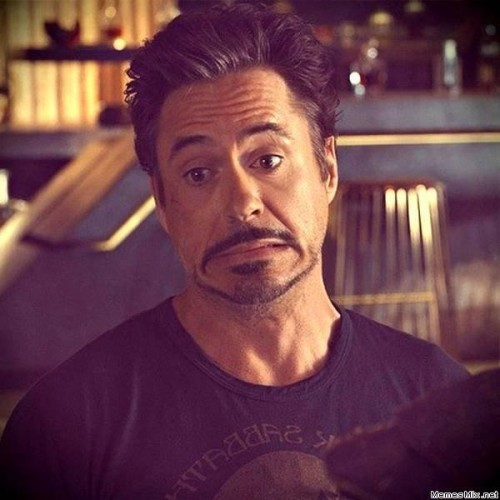

### Other chains
- Gibbs
- HMC
- NUTS

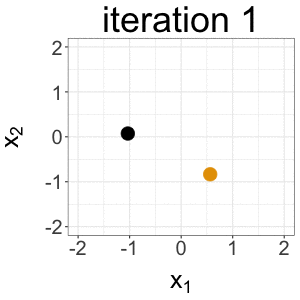
Credit: https://statisfaction.wordpress.com/2017/09/17/unbiased-hamiltonian-monte-carlo-with-couplings/

## I came to hear about particle filters though

Sources of randomness:
- Proposal sampling -> coupled as before (e.g. MCMC)
- Resampling -> ?

## Coupling of resampling schemes

1. $\mathbb{P}(A^1_i = k) = W_k^1$
2. $\mathbb{P}(A^2_i = k) = W_k^2$
3. $\mathbb{P}(A^1_i \neq A^2_i) << 1$

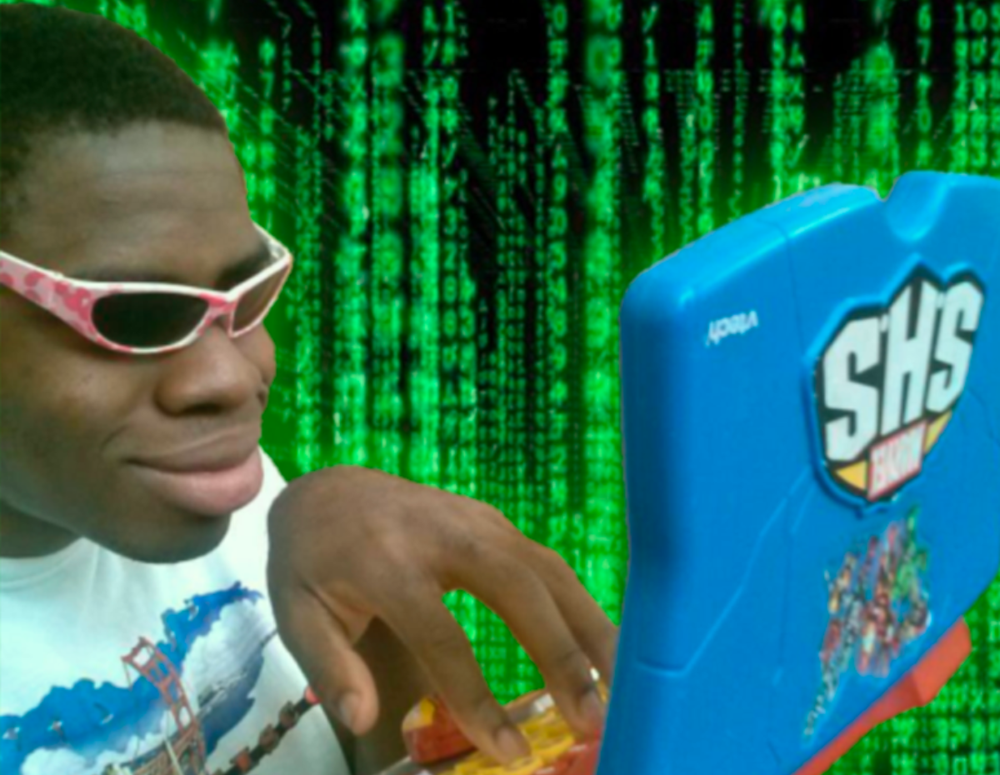

In [23]:
def index_coupled_resampling(w_1, w_2):
    N = w_1.shape[0]

    nu = np.minimum(w_1, w_2)
    alpha = np.sum(nu)
    mu = nu / alpha

    # residuals
    r_1, r_2 = (w_1 - nu) / (1 - alpha), (w_2 - nu) / (1 - alpha)

    # sample from the coupling mixture
    uniforms = np.random.rand(N)
    coupled = uniforms < alpha
    
    where_coupled = multinomial(mu)  # where the two are coupled, simply sample from mu

    # otherwise sample from the residuals with a common random number
    where_not_coupled_1 = multinomial(r_1)
    where_not_coupled_2 = multinomial(r_2)

    idx_1 = np.where(coupled, where_coupled, where_not_coupled_1)
    idx_2 = np.where(coupled, where_coupled, where_not_coupled_2)
    return idx_1, idx_2

In [24]:
W_1, W_2 = np.random.rand(500), np.random.rand(500)
W_1, W_2 = W_1 / W_1.sum(), W_2 / W_2.sum()
A_1, A_2 = index_coupled_resampling(W_1, W_2)
np.sum(A_1 == A_2), np.sum(multinomial(W_1) == multinomial(W_2))

(355, 28)

## So what?

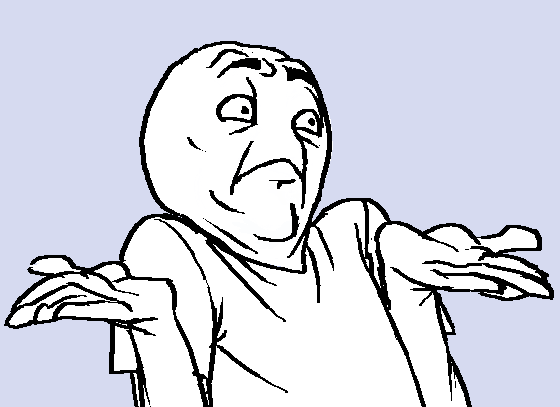

Correlated estimates can be used to produce correlated PMCMC algorithms, reducing the noise and increasing acceptance rate. 

- Correlated likelihood estimates -> PMCMC

Coupled trajectories can be used in smoothing via iterated conditional SMC.

- Correlated trajectories samples -> Smoothing via PGibbs

## Conditional particle filter

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
xdata, ydata = [], []
ln, = plt.plot([], [], 'ro')

def init():
    ax.set_xlim(0, 2*np.pi)
    ax.set_ylim(-1, 1)
    return ln,

def update(frame):
    xdata.append(frame)
    ydata.append(np.sin(frame))
    ln.set_data(xdata, ydata)
    return ln,

ani = FuncAnimation(fig, update, frames=np.linspace(0, 2*np.pi, 128),
                    init_func=init, blit=True)
plt.show()

In [25]:
def cpf(N, traj):
    xs = np.empty((T+1, 1, N))
    xs[..., 0] = traj  # HERE!
    xs[0, :, 1:] = np.random.randn(1, N - 1)
    w = stats.multivariate_normal.pdf(ys[None, 0] - (H @ xs[0]).T)
    W = w / w.sum()
    A = multinomial(W)
    A[0] = 0  # HERE!
    xs = xs[..., A]
    for t in range(T):
        xs[t+1, :, 1:] = F @ xs[t, :, 1:] + np.random.randn(1, N-1)  # HERE !
        w = stats.multivariate_normal.pdf(ys[None, t+1] - (H @ xs[t+1]).T)
        W = w / w.sum()
        A = multinomial(W)
        A[0] = 0  # HERE!
        xs = xs[..., A]
    return xs

In [55]:
traj = pf(50)[..., np.random.randint(50)]
n_iter = 100
trajs = np.empty((n_iter, T+1, 1))
trajs[0] = traj
for i in range(1, n_iter):
    traj = cpf(50, traj)[..., 1 + np.random.randint(49)]
    trajs[i] = traj
animate(trajs[:-1], trajs[1:])

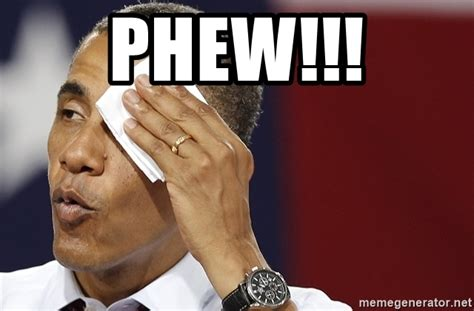

In [57]:
def coupled_cpf(N, traj_1, traj_2):
    xs_1 = np.empty((T+1, 1, N))
    xs_2 = np.empty((T+1, 1, N))
    
    xs_1[..., 0], xs_2[..., 0] = traj_1, traj_2  # HERE!
    
    xs_1[0, :, 1:] = xs_2[0, :, 1:] = np.random.randn(1, N - 1)  # Common random numbers !
    w_1 = stats.multivariate_normal.pdf(ys[None, 0] - (H @ xs_1[0]).T)
    w_2 = stats.multivariate_normal.pdf(ys[None, 0] - (H @ xs_2[0]).T)
    W_1, W_2 = w_1 / w_1.sum(), w_2 / w_2.sum()
    A_1, A_2 = index_coupled_resampling(W_1, W_2)
    A_1[0] = A_2[0] = 0  # HERE!
    xs_1 = xs_1[..., A_1]
    xs_2 = xs_2[..., A_2]
    for t in range(T):
        eps = np.random.randn(1, N-1)  # Common random numbers !
        xs_1[t+1, :, 1:] = F @ xs_1[t, :, 1:] + eps  # HERE !
        xs_2[t+1, :, 1:] = F @ xs_2[t, :, 1:] + eps  # HERE !
        w_1 = stats.multivariate_normal.pdf(ys[None, t+1] - (H @ xs_1[t+1]).T)
        w_2 = stats.multivariate_normal.pdf(ys[None, t+1] - (H @ xs_2[t+1]).T)
        W_1, W_2 = w_1 / w_1.sum(), w_2 / w_2.sum()
        A_1, A_2 = index_coupled_resampling(W_1, W_2)
        A_1[0] = A_2[0] = 0  # HERE!
        xs_1 = xs_1[..., A_1]
        xs_2 = xs_2[..., A_2]
    return xs_1, xs_2

In [56]:
traj_1 = pf(50)[..., np.random.randint(50)]
traj_2 = pf(50)[..., np.random.randint(50)]

n_iter = 100
trajs_1 = np.empty((n_iter, T+1, 1))
trajs_2 = np.empty((n_iter, T+1, 1))

trajs_1[0] = traj_1
trajs_2[0] = traj_2

for i in range(1, n_iter):
    print(f"iterate {i+1}/{n_iter}", end="\r")
    randint = 1 + np.random.randint(49)
    traj_1, traj_2 = coupled_cpf(50, traj_1, traj_2)
    traj_1 = traj_1[..., randint]
    traj_2 = traj_2[..., randint]
    trajs_1[i] = traj_1
    trajs_2[i] = traj_2
    
    
animate(trajs_1, trajs_2)

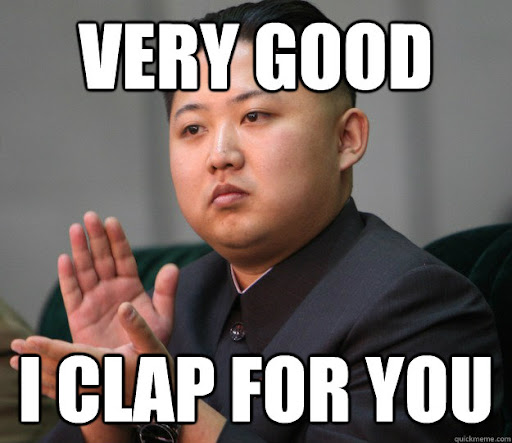

## References 

On request.